In [68]:
# Imports
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import statsmodels.api as sm
import scipy.stats as stats
from sklearn.linear_model import LinearRegression
from statsmodels.stats.outliers_influence import variance_inflation_factor, OLSInfluence

%config InlineBackend.figure_formats = ['svg']  # or svg
%matplotlib inline

sns.set(context='notebook', style='darkgrid', font_scale=0.8, rc={
    'axes.facecolor':'#2b41bc', 
    'axes.grid.which': 'major', 
    'grid.color': '#ffffff'})

## MVP - Spotify song popularity predictor
### Importing and cleaning data

For this project I am training a model using Spotify track metadata to predict a song's popularity. I have a dataset of 4963 rows and 13 numerical features. 

The dataset was acquired as follows:

- 1277 rows were scraped from the Spotify Top 200 weekly charts for the year between 09-01-2021 and 09-01-2020
- 4099 rows were scraped from Spotify's API using random search terms
- 228159 rows were downloaded from Kaggle to provide a larger and more distributed dataset

The target is the variable `popularity` which is calculated by Spotify based on an algorithm that includes current listening numbers, which indicates that `popularity` is a time-based measure, e.g. older tracks will likely have lower popularity scores.

In [2]:
# import data

df = pd.read_csv('/Users/joycetagal/Github/metis/reg/SpotifyFeatures.csv')

In [3]:
df.shape

(228159, 18)

<AxesSubplot:xlabel='popularity', ylabel='Count'>

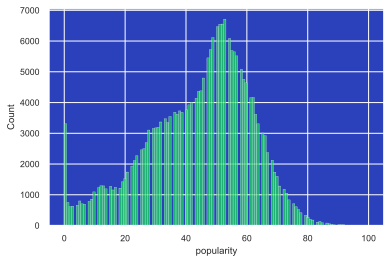

In [69]:
sns.histplot(df['popularity'], color='#1ed65f')

In [70]:
# Let's reduce computation time by taking 10,000 rows as a sample

sample_df = df.sample(n=10000, random_state=44)

In [71]:
sample_df.head()

,genre,artist_name,track_name,track_id,popularity,acousticness,danceability,duration_ms,energy,instrumentalness,key,liveness,loudness,mode,speechiness,tempo,time_signature,valence
53612,Anime,Five Finger Death Punch,Sham Pain,2jWBH2mvHuisHxhpDbHSXP,65,0.000172,0.555,209703,0.950,0.000003,B,0.140,-3.948,Minor,0.0576,96.508,4/4,0.385
43600,Children’s Music,Brick + Mortar,Train,5fAeD0Y8eG2EWN2e5ZRpxa,60,0.043300,0.596,185030,0.729,0.151000,G,0.135,-5.820,Major,0.0698,149.999,4/4,0.560
221932,World,Israel & New Breed,No Hay Vuelta Atrás,6qFnOnZvvKkqk5eNP7BhYC,32,0.099800,0.676,350467,0.965,0.000000,C#,0.589,-3.324,Major,0.1710,94.998,4/4,0.582
214492,Rock,Declan McKenna,The Kids Don't Wanna Come Home - Single Version,6lj0jgxdeE6wFqddzYY0Sd,58,0.037700,0.523,260400,0.790,0.000000,G,0.174,-5.665,Major,0.0353,121.989,4/4,0.338
114189,Hip-Hop,Nipsey Hussle,They Roll (feat. the Game),04y6gszHT7GAiHwgsFF6yI,50,0.255000,0.659,209667,0.741,0.000000,C#,0.425,-4.553,Minor,0.2100,87.050,4/4,0.427


In [72]:
sample_df.shape

(10000, 18)

In [73]:
sample_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 10000 entries, 53612 to 136746
Data columns (total 18 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   genre             10000 non-null  object 
 1   artist_name       10000 non-null  object 
 2   track_name        10000 non-null  object 
 3   track_id          10000 non-null  object 
 4   popularity        10000 non-null  int64  
 5   acousticness      10000 non-null  float64
 6   danceability      10000 non-null  float64
 7   duration_ms       10000 non-null  int64  
 8   energy            10000 non-null  float64
 9   instrumentalness  10000 non-null  float64
 10  key               10000 non-null  object 
 11  liveness          10000 non-null  float64
 12  loudness          10000 non-null  float64
 13  mode              10000 non-null  object 
 14  speechiness       10000 non-null  float64
 15  tempo             10000 non-null  float64
 16  time_signature    10000 non-null  o

In [74]:
sample_df.dropna(inplace=True)

In [10]:
# coerce some categoricals to in
# spotify_df = spotify_df.astype({'key': int, 'mode': int, 'time_signature': int})

## Visualizing and exploring data
### Covariance, Correlation, and Collinearity

In [75]:
spotify_df = sample_df.select_dtypes(exclude=['object']).copy() # Drop non-numerical columns

In [76]:
spotify_df.head()

,popularity,acousticness,danceability,duration_ms,energy,instrumentalness,liveness,loudness,speechiness,tempo,valence
53612,65,0.000172,0.555,209703,0.950,0.000003,0.140,-3.948,0.0576,96.508,0.385
43600,60,0.043300,0.596,185030,0.729,0.151000,0.135,-5.820,0.0698,149.999,0.560
221932,32,0.099800,0.676,350467,0.965,0.000000,0.589,-3.324,0.1710,94.998,0.582
214492,58,0.037700,0.523,260400,0.790,0.000000,0.174,-5.665,0.0353,121.989,0.338
114189,50,0.255000,0.659,209667,0.741,0.000000,0.425,-4.553,0.2100,87.050,0.427


In [77]:
spotify_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 10000 entries, 53612 to 136746
Data columns (total 11 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   popularity        10000 non-null  int64  
 1   acousticness      10000 non-null  float64
 2   danceability      10000 non-null  float64
 3   duration_ms       10000 non-null  int64  
 4   energy            10000 non-null  float64
 5   instrumentalness  10000 non-null  float64
 6   liveness          10000 non-null  float64
 7   loudness          10000 non-null  float64
 8   speechiness       10000 non-null  float64
 9   tempo             10000 non-null  float64
 10  valence           10000 non-null  float64
dtypes: float64(9), int64(2)
memory usage: 937.5 KB


<AxesSubplot:xlabel='popularity', ylabel='Count'>

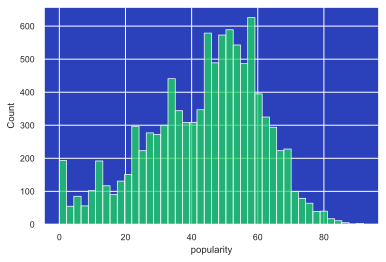

In [79]:
sns.histplot(spotify_df['popularity'], color='#1ed65f')

In [80]:
spotify_df.corr()

,popularity,acousticness,danceability,duration_ms,energy,instrumentalness,liveness,loudness,speechiness,tempo,valence
popularity,1.000000,-0.425615,0.299323,-0.050267,0.279746,-0.223482,-0.209682,0.410664,-0.203803,0.111612,0.124874
acousticness,-0.425615,1.000000,-0.389545,0.039514,-0.717819,0.315925,0.094914,-0.695898,0.180182,-0.239736,-0.339805
danceability,0.299323,-0.389545,1.000000,-0.116072,0.354293,-0.362133,-0.013122,0.463289,0.137677,0.009507,0.545316
duration_ms,-0.050267,0.039514,-0.116072,1.000000,-0.066381,0.082028,0.012820,-0.076763,-0.005996,-0.032351,-0.137073
energy,0.279746,-0.717819,0.354293,-0.066381,1.000000,-0.379676,0.183768,0.812219,0.153160,0.216047,0.454589
instrumentalness,-0.223482,0.315925,-0.362133,0.082028,-0.379676,1.000000,-0.136859,-0.504298,-0.169823,-0.105359,-0.305454
liveness,-0.209682,0.094914,-0.013122,0.012820,0.183768,-0.136859,1.000000,0.036485,0.541160,-0.066598,0.029821
loudness,0.410664,-0.695898,0.463289,-0.076763,0.812219,-0.504298,0.036485,1.000000,-0.004292,0.219606,0.410539
speechiness,-0.203803,0.180182,0.137677,-0.005996,0.153160,-0.169823,0.541160,-0.004292,1.000000,-0.088380,0.039465
tempo,0.111612,-0.239736,0.009507,-0.032351,0.216047,-0.105359,-0.066598,0.219606,-0.088380,1.000000,0.100199


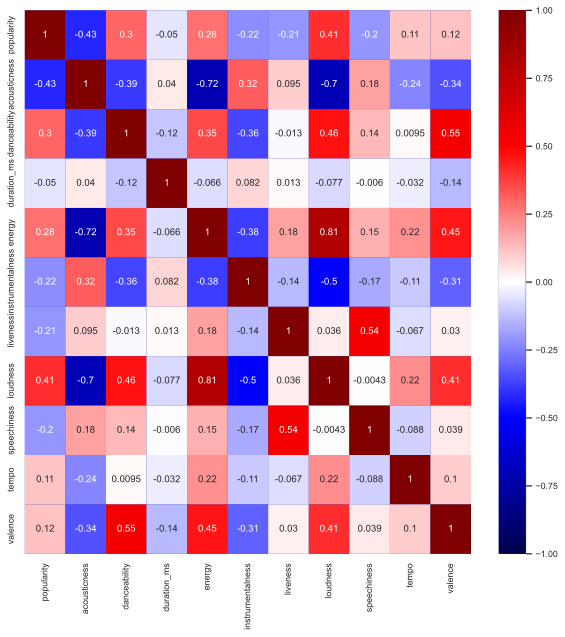

In [81]:
f, ax = plt.subplots(figsize=(10, 10))
sns.heatmap(spotify_df.corr(), cmap="seismic", annot=True, vmin=-1, vmax=1);

In [82]:
spotify_df.corr()['popularity'].sort_values(ascending=False)

popularity          1.000000
loudness            0.410664
danceability        0.299323
energy              0.279746
valence             0.124874
tempo               0.111612
duration_ms        -0.050267
speechiness        -0.203803
liveness           -0.209682
instrumentalness   -0.223482
acousticness       -0.425615
Name: popularity, dtype: float64

The correlations calculations show that several variables have high correlation with `popularity`, namely `loudness`, `danceability`, `energy`, `acousticness`. 

Overall it seems as if the popularity of the track has to do with the overall energy of the track.

In [83]:
sns.pairplot(spotify_df[['popularity', 'loudness', 'energy', 'danceability', 'acousticness']])

Simply based on the pairplot, only `loudness` shows a visual linear relationship. Some other things to note:

- The variables `energy` and `loudness` are positively correlated, which makes intuitive sense.

Intuitively, we can presume that the random selection of songs we have chosen are from a diverse set of genres, and therefore, will be 'popular' with listeners based on a number of different traits. 

Let's do an initial model and then try a subset of data within a specific genre.

## Initial model

In [84]:
x_df = spotify_df.drop(columns=['popularity'])
y_df = spotify_df['popularity']
lm = LinearRegression()
sk_fit = lm.fit(x_df, y_df)
sk_fit.score(x_df, y_df)

0.2819924049903677

The R^2 given additional data is significantly better compared to the model with 5000 rows of data. This is likely because the selection of the data is much more random, especially for the distribution of the target.

In [85]:
#Create the model
add_model = sm.OLS(y_df, sm.add_constant(x_df))

#Fit
add_fit = add_model.fit()

#Print out summary
add_fit.summary()

/Users/joycetagal/opt/anaconda3/envs/metis/lib/python3.8/site-packages/statsmodels/tsa/tsatools.py:142: FutureWarning: In a future version of pandas all arguments of concat except for the argument 'objs' will be keyword-only
  x = pd.concat(x[::order], 1)


<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:             popularity   R-squared:                       0.282
Model:                            OLS   Adj. R-squared:                  0.281
Method:                 Least Squares   F-statistic:                     392.3
Date:                Tue, 12 Oct 2021   Prob (F-statistic):               0.00
Time:                        16:40:17   Log-Likelihood:                -41102.
No. Observations:               10000   AIC:                         8.223e+04
Df Residuals:                    9989   BIC:                         8.231e+04
Df Model:                          10                                         
Covariance Type:            nonrobust                                         
====================================================================================
                       coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------------
const               57.4848      1.551     37.052      0.000      54.444      60.526
acousticness       -11.0468      0.707    -15.623      0.000     -12.433      -9.661
danceability        17.1253      1.090     15.715      0.000      14.989      19.261
duration_ms      -2.678e-06   1.28e-06     -2.088      0.037   -5.19e-06   -1.64e-07
energy              -5.8822      1.255     -4.688      0.000      -8.342      -3.423
instrumentalness    -3.5668      0.615     -5.799      0.000      -4.772      -2.361
liveness           -10.6622      0.903    -11.808      0.000     -12.432      -8.892
loudness             0.7858      0.051     15.521      0.000       0.687       0.885
speechiness        -10.2913      1.038     -9.914      0.000     -12.326      -8.257
tempo                0.0027      0.005      0.530      0.596      -0.007       0.013
valence             -9.1454      0.754    -12.131      0.000     -10.623      -7.668
==============================================================================
Omnibus:                      256.266   Durbin-Watson:                   2.016
Prob(Omnibus):                  0.000   Jarque-Bera (JB):              275.804
Skew:                          -0.400   Prob(JB):                     1.29e-60
Kurtosis:                       3.149   Cond. No.                     3.68e+06
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
[2] The condition number is large, 3.68e+06. This might indicate that there are
strong multicollinearity or other numerical problems.
"""

## Checking residual plots

In [89]:
def diagnostic_plots(y_pred, y_true, resid):
    fig, axes = plt.subplots(1, 3, figsize=(10, 4))

    g1 = sns.regplot(x=y_pred, y=y_true, ci=False, line_kws={'color': 'red'}, ax=axes[0], scatter_kws={'s': 5, 'color': '#1ed65f'})
    g1.set_xlabel('Predicted Target')
    g1.set_ylabel('True Target')
    g1.set_title('Regression fit')

    g2 = sns.regplot(x=y_pred, y=resid, lowess=True, ax=axes[1], line_kws={'color': 'red'}, scatter_kws={'s': 5, 'color': '#1ed65f'})
    g2.set_xlabel('Predicted Target')
    g2.set_ylabel('Residual')
    g2.axhline(y=0, color='gray', linestyle='--')
    g2.set_title('Residual plot')

    g3 = stats.probplot(resid, dist="norm", plot=axes[2])

    fig.suptitle('Diagnostic Plots');
    fig.tight_layout();

In [90]:
diagnostic_plots(add_fit.fittedvalues, y_df, add_fit.resid)

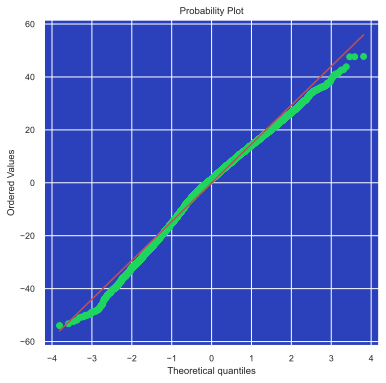

In [51]:
fig = plt.figure(figsize=[6, 6], dpi=100)
ax = fig.add_subplot(111)
fig = stats.probplot(fit.resid, dist="norm", plot=plt)

#ax.get_lines()[0].set_marker('p')
ax.get_lines()[0].set_markerfacecolor('#1ed65f')
ax.get_lines()[0].set_markeredgecolor('#1ed65f')
#ax.get_lines()[0].set_markersize(12.0)

## Log popularity - Transform target

In [91]:
# remove zero values from df
spotify_df = spotify_df[spotify_df['popularity'] > 1]

<AxesSubplot:>

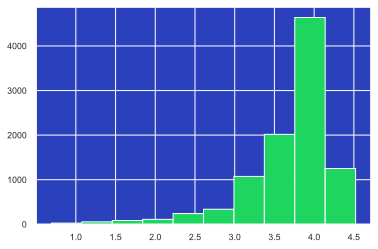

In [93]:
import numpy as np
np.log(spotify_df['popularity']).hist(color = '#1ed65f')

In [94]:
spotify_df['log_pop'] = np.log(spotify_df['popularity'])

In [95]:
x_df = spotify_df.drop(columns=['popularity', 'log_pop'])
y_df = spotify_df['log_pop']
lm = LinearRegression()
sk_fit = lm.fit(x_df, y_df)
sk_fit.score(x_df, y_df)

0.27160494045187433

In [97]:
#Create the model
log_model = sm.OLS(y_df, sm.add_constant(x_df))

#Fit
log_fit = log_model.fit()

#Print out summary
log_fit.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:                log_pop   R-squared:                       0.272
Model:                            OLS   Adj. R-squared:                  0.271
Method:                 Least Squares   F-statistic:                     366.2
Date:                Tue, 12 Oct 2021   Prob (F-statistic):               0.00
Time:                        17:06:07   Log-Likelihood:                -6328.2
No. Observations:                9833   AIC:                         1.268e+04
Df Residuals:                    9822   BIC:                         1.276e+04
Df Model:                          10                                         
Covariance Type:            nonrobust                                         
====================================================================================
                       coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------------
const                4.0492      0.049     82.429      0.000       3.953       4.145
acousticness        -0.3704      0.022    -16.604      0.000      -0.414      -0.327
danceability         0.5164      0.034     15.102      0.000       0.449       0.583
duration_ms       3.836e-08   4.34e-08      0.884      0.377   -4.67e-08    1.23e-07
energy              -0.1882      0.040     -4.756      0.000      -0.266      -0.111
instrumentalness     0.0253      0.019      1.297      0.195      -0.013       0.063
liveness            -0.3463      0.028    -12.150      0.000      -0.402      -0.290
loudness             0.0251      0.002     15.620      0.000       0.022       0.028
speechiness         -0.2742      0.033     -8.339      0.000      -0.339      -0.210
tempo                0.0002      0.000      1.066      0.287      -0.000       0.000
valence             -0.2186      0.024     -9.196      0.000      -0.265      -0.172
==============================================================================
Omnibus:                     4052.257   Durbin-Watson:                   2.008
Prob(Omnibus):                  0.000   Jarque-Bera (JB):            23050.004
Skew:                          -1.904   Prob(JB):                         0.00
Kurtosis:                       9.462   Cond. No.                     3.63e+06
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
[2] The condition number is large, 3.63e+06. This might indicate that there are
strong multicollinearity or other numerical problems.
"""

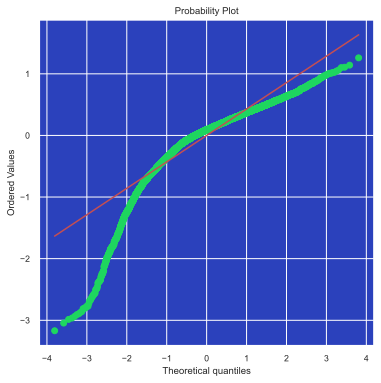

In [99]:
fig = plt.figure(figsize=[6, 6], dpi=100)
ax = fig.add_subplot(111)
fig = stats.probplot(log_fit.resid, dist="norm", plot=plt)

ax.get_lines()[0].set_markerfacecolor('#1ed65f')
ax.get_lines()[0].set_markeredgecolor('#1ed65f')

The log transformation does not seem to improve the tail of the prob-plot. It's possible another transformation may do the trick, but at this point we may be sacrificing interpretability for accuracy.

### Variable Inflation Factor

In [23]:
def vif(df_X):
    '''
    Calculate the VIF for each feature of df_X (a Pandas DataFrame).
    '''
    vif_data = [variance_inflation_factor(df_X.values, i)
                for i in range(df_X.shape[1])]
    
    return pd.Series(vif_data, index=df_X.columns)

In [24]:
# We only analyze the VIF for predictors
vif(spotify_df.iloc[:, 1:])

acousticness         4.626106
danceability        12.200469
duration_ms          4.965442
energy              14.431041
instrumentalness     1.790203
liveness             3.270690
loudness             8.431013
speechiness          2.285292
tempo               13.604869
valence              6.624052
dtype: float64

## Adding genre dummies

In [25]:
genre_df = sample_df
genre_df = genre_df.select_dtypes(exclude=['object']).copy().reset_index().drop(columns=['index'])
genre_df.head()

,popularity,acousticness,danceability,duration_ms,energy,instrumentalness,liveness,loudness,speechiness,tempo,valence
0,65,0.000172,0.555,209703,0.950,0.000003,0.140,-3.948,0.0576,96.508,0.385
1,60,0.043300,0.596,185030,0.729,0.151000,0.135,-5.820,0.0698,149.999,0.560
2,32,0.099800,0.676,350467,0.965,0.000000,0.589,-3.324,0.1710,94.998,0.582
3,58,0.037700,0.523,260400,0.790,0.000000,0.174,-5.665,0.0353,121.989,0.338
4,50,0.255000,0.659,209667,0.741,0.000000,0.425,-4.553,0.2100,87.050,0.427


In [26]:
genre_dummies = pd.get_dummies(sample_df['genre'])
genre_dummies = genre_dummies.reset_index().drop(columns=['index'])

In [27]:
genre_df.columns

Index(['popularity', 'acousticness', 'danceability', 'duration_ms', 'energy',
       'instrumentalness', 'liveness', 'loudness', 'speechiness', 'tempo',
       'valence'],
      dtype='object')

In [100]:
len(genre_dummies.columns)

26

In [29]:
genre_dummies.head()

,A Capella,Alternative,Anime,Blues,Children’s Music,Classical,Comedy,Country,Dance,Electronic,...,Pop,R&B,Rap,Reggae,Reggaeton,Rock,Ska,Soul,Soundtrack,World
0,0,0,1,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1,0,0,0,0,1,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,1
3,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,1,0,0,0,0
4,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [30]:
genre_df = genre_df.join(genre_dummies)

In [31]:
genre_df.shape

(10000, 37)

In [32]:
genre_df.head()

,popularity,acousticness,danceability,duration_ms,energy,instrumentalness,liveness,loudness,speechiness,tempo,...,Pop,R&B,Rap,Reggae,Reggaeton,Rock,Ska,Soul,Soundtrack,World
0,65,0.000172,0.555,209703,0.950,0.000003,0.140,-3.948,0.0576,96.508,...,0,0,0,0,0,0,0,0,0,0
1,60,0.043300,0.596,185030,0.729,0.151000,0.135,-5.820,0.0698,149.999,...,0,0,0,0,0,0,0,0,0,0
2,32,0.099800,0.676,350467,0.965,0.000000,0.589,-3.324,0.1710,94.998,...,0,0,0,0,0,0,0,0,0,1
3,58,0.037700,0.523,260400,0.790,0.000000,0.174,-5.665,0.0353,121.989,...,0,0,0,0,0,1,0,0,0,0
4,50,0.255000,0.659,209667,0.741,0.000000,0.425,-4.553,0.2100,87.050,...,0,0,0,0,0,0,0,0,0,0


In [106]:
x = genre_df.drop(columns=['popularity'])
y = genre_df['popularity']
lm_genre = LinearRegression()

genre_fit = lm_genre.fit(x, y)
lm_genre.score(x, y)

0.7021573662377019

In [107]:
#Create the model
genre_model = sm.OLS(y, sm.add_constant(x))

#Fit
genre_fit = genre_model.fit()

#Print out summary
genre_fit.summary()

/Users/joycetagal/opt/anaconda3/envs/metis/lib/python3.8/site-packages/statsmodels/tsa/tsatools.py:142: FutureWarning: In a future version of pandas all arguments of concat except for the argument 'objs' will be keyword-only
  x = pd.concat(x[::order], 1)


<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:             popularity   R-squared:                       0.702
Model:                            OLS   Adj. R-squared:                  0.701
Method:                 Least Squares   F-statistic:                     671.1
Date:                Tue, 12 Oct 2021   Prob (F-statistic):               0.00
Time:                        17:15:58   Log-Likelihood:                -36703.
No. Observations:               10000   AIC:                         7.348e+04
Df Residuals:                    9964   BIC:                         7.374e+04
Df Model:                          35                                         
Covariance Type:            nonrobust                                         
====================================================================================
                       coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------------
const               43.2490      1.009     42.844      0.000      41.270      45.228
acousticness         0.3472      0.488      0.711      0.477      -0.610       1.304
danceability         2.3979      0.790      3.036      0.002       0.850       3.946
duration_ms       4.153e-07   8.51e-07      0.488      0.626   -1.25e-06    2.08e-06
energy              -1.2390      0.841     -1.474      0.141      -2.887       0.409
instrumentalness    -0.5127      0.455     -1.128      0.259      -1.404       0.378
liveness            -1.5617      0.600     -2.603      0.009      -2.738      -0.386
loudness             0.1338      0.035      3.847      0.000       0.066       0.202
speechiness         -3.0386      1.001     -3.036      0.002      -5.001      -1.077
tempo               -0.0073      0.003     -2.222      0.026      -0.014      -0.001
valence             -0.7187      0.514     -1.398      0.162      -1.727       0.289
A Capella          -29.6600      3.754     -7.900      0.000     -37.019     -22.301
Alternative         13.4495      0.521     25.817      0.000      12.428      14.471
Anime               13.2966      0.495     26.843      0.000      12.326      14.268
Blues               13.3596      0.505     26.453      0.000      12.370      14.350
Children’s Music    13.5814      0.486     27.919      0.000      12.628      14.535
Classical          -10.8620      0.629    -17.273      0.000     -12.095      -9.629
Comedy             -16.6095      0.878    -18.924      0.000     -18.330     -14.889
Country              5.3832      0.512     10.521      0.000       4.380       6.386
Dance               15.7079      0.502     31.301      0.000      14.724      16.692
Electronic          -3.1252      0.517     -6.047      0.000      -4.138      -2.112
Folk                 8.3871      0.489     17.139      0.000       7.428       9.346
Hip-Hop             16.5456      0.523     31.658      0.000      15.521      17.570
Indie               13.6189      0.463     29.429      0.000      12.712      14.526
Jazz                -0.0678      0.514     -0.132      0.895      -1.076       0.941
Movie              -27.7178      0.530    -52.264      0.000     -28.757     -26.678
Opera              -26.9389      0.590    -45.654      0.000     -28.096     -25.782
Pop                 25.1589      0.504     49.967      0.000      24.172      26.146
R&B                  9.9526      0.513     19.402      0.000       8.947      10.958
Rap                 19.6676      0.508     38.685      0.000      18.671      20.664
Reggae              -6.4304      0.511    -12.582      0.000      -7.432      -5.429
Reggaeton           -2.8166      0.525     -5.369      0.000      -3.845      -1.788
Rock                18.7612      0.507     37.040      0.000      17.768      19.754
Ska                -12.

In [109]:
diagnostic_plots(genre_fit.fittedvalues, y, genre_fit.resid)

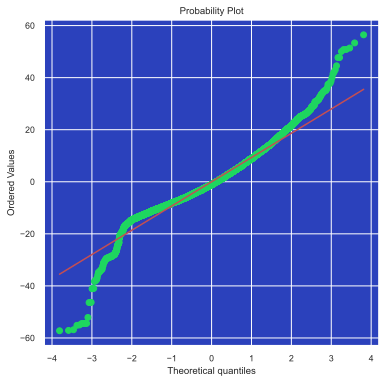

In [110]:
fig = plt.figure(figsize=[6, 6], dpi=100)
ax = fig.add_subplot(111)
fig = stats.probplot(genre_fit.resid, dist="norm", plot=plt)

ax.get_lines()[0].set_markerfacecolor('#1ed65f')
ax.get_lines()[0].set_markeredgecolor('#1ed65f')

This Probplot still looks a bit funky in the tail, but the R^2 has increased drastically with the inclusion of the dummies!

## Train/Validate/Test

In [113]:
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression, Ridge #ordinary linear regression + w/ ridge regularization
from sklearn.preprocessing import StandardScaler, PolynomialFeatures

In [121]:
test_df = df.sample(n=10000, random_state=80) # take a new dataset of 10,000 rows

In [122]:
test_df_num = test_df.select_dtypes(exclude=['object']).copy().reset_index(drop=True)

In [123]:
test_df_num.head()

,popularity,acousticness,danceability,duration_ms,energy,instrumentalness,liveness,loudness,speechiness,tempo,valence
0,62,0.53600,0.632,173057,0.3970,0.0421,0.1060,-12.855,0.0265,110.578,0.7310
1,51,0.05510,0.670,316360,0.5630,0.0000,0.0660,-6.749,0.3550,145.753,0.6850
2,64,0.10100,0.772,202500,0.8490,0.0000,0.0857,-3.035,0.2000,127.972,0.6420
3,23,0.94000,0.192,656400,0.0241,0.5880,0.3420,-29.197,0.0445,135.888,0.0341
4,47,0.00171,0.360,215840,0.8150,0.0000,0.1210,-3.863,0.0465,163.999,0.2100


In [126]:
test_dummies = pd.get_dummies(test_df['genre'])
test_dummies = test_dummies.reset_index(drop=True)
test_dummies.head()

,A Capella,Alternative,Anime,Blues,Children’s Music,Classical,Comedy,Country,Dance,Electronic,...,Pop,R&B,Rap,Reggae,Reggaeton,Rock,Ska,Soul,Soundtrack,World
0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,1,0,0,0,0
1,0,0,0,0,0,0,0,0,0,0,...,0,0,1,0,0,0,0,0,0,0
2,0,0,0,0,0,0,0,0,1,0,...,0,0,0,0,0,0,0,0,0,0
3,0,0,0,0,0,1,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
4,0,0,0,0,1,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [129]:
test_df = test_df_num.join(test_dummies)
test_df.head()

,popularity,acousticness,danceability,duration_ms,energy,instrumentalness,liveness,loudness,speechiness,tempo,...,Pop,R&B,Rap,Reggae,Reggaeton,Rock,Ska,Soul,Soundtrack,World
0,62,0.53600,0.632,173057,0.3970,0.0421,0.1060,-12.855,0.0265,110.578,...,0,0,0,0,0,1,0,0,0,0
1,51,0.05510,0.670,316360,0.5630,0.0000,0.0660,-6.749,0.3550,145.753,...,0,0,1,0,0,0,0,0,0,0
2,64,0.10100,0.772,202500,0.8490,0.0000,0.0857,-3.035,0.2000,127.972,...,0,0,0,0,0,0,0,0,0,0
3,23,0.94000,0.192,656400,0.0241,0.5880,0.3420,-29.197,0.0445,135.888,...,0,0,0,0,0,0,0,0,0,0
4,47,0.00171,0.360,215840,0.8150,0.0000,0.1210,-3.863,0.0465,163.999,...,0,0,0,0,0,0,0,0,0,0


In [130]:
X, y = test_df.drop('popularity', axis=1), test_df['popularity']

X, X_test, y, y_test = train_test_split(X, y, test_size=.2, random_state=32)

In [131]:
X_train, X_val, y_train, y_val = train_test_split(X, y, test_size=.25, random_state=46)

### Set up models


In [132]:
#set up the 3 models we're choosing from:

lm = LinearRegression()

#Feature scaling for train, val, and test for ridge model
scaler = StandardScaler()

X_train_scaled = scaler.fit_transform(X_train.values)
X_val_scaled = scaler.transform(X_val.values)
X_test_scaled = scaler.transform(X_test.values)

lm_reg = Ridge(alpha=1)

#Feature transforms for train, val, and test for poly model
poly = PolynomialFeatures(degree=2) 

X_train_poly = poly.fit_transform(X_train.values)
X_val_poly = poly.transform(X_val.values)
X_test_poly = poly.transform(X_test.values)

lm_poly = LinearRegression()

In [133]:
#validate

lm.fit(X_train, y_train)
print(f'Linear Regression val R^2: {lm.score(X_val, y_val):.3f}')

lm_reg.fit(X_train_scaled, y_train)
print(f'Ridge Regression val R^2: {lm_reg.score(X_val_scaled, y_val):.3f}')

lm_poly.fit(X_train_poly, y_train)
print(f'Degree 2 polynomial regression val R^2: {lm_poly.score(X_val_poly, y_val):.3f}')

Linear Regression val R^2: 0.721
Ridge Regression val R^2: 0.721
Degree 2 polynomial regression val R^2: -1.977


The LR model fits better than the polynomial, and the same as the ridge (which makes sense because the features are all mostly scaled between 0-1 anyway.

In [135]:
lm.score(X_train, y_train)

0.6957828425342917

In [134]:
# train on full train set, then run on test data
lm.fit(X,y)
print(f'Linear Regression test R^2: {lm.score(X_test, y_test):.3f}')

Linear Regression test R^2: 0.698


Overall, our LR model is doing well compared to the polynomial. Definitely a huge improvement over the inital E^2 of 0.07! Let's calculate 2 more metrics for the model for interpretability.

In [136]:
y_pred = lm.predict(X_test)

In [141]:
import sklearn.metrics as metrics
from sklearn.metrics import mean_absolute_error, mean_squared_error

print(metrics.mean_absolute_error(y_test, y_pred))
print(np.sqrt(metrics.mean_squared_error(y_test, y_pred)))

7.195474836729573
9.447591627755468


A spread of 7.2 and 9.4 over 100 points for popularity is not bad.